In [2]:
import mmcv
import cv2
import matplotlib.pyplot as plt
import os
from mmcv import Config
from mmdet.apis import inference_detector, init_detector

In [17]:
def visualise_img(img_name, data_dir, checkpoint, config):
    """ Visualizes an image with bboxes and groundtruth. 

    Args:
        img_name (str): The name of the file wihtou ext
        data_dir (str): The location of the data
        checkpoint (str): checkpoint location of the model
        config (dict): configuration dict specifing the model
    """
    # print(data_dir)
    img_name = os.path.splitext(img_name)[0]
    cfg = Config.fromfile(config)

    img = mmcv.imread(f'{data_dir}/images/{img_name}.jpg')
    label_file = f"{data_dir}/labels/{img_name}.txt"

    with open(label_file) as f:
        gt = f.readlines()[0]

    label = gt.split(" ")[2:6]
    label = label + [1.0]
    
    # initialize the detector
    model = init_detector(config, checkpoint, device='cuda:0')

    # model.cfg = cfg
    result = inference_detector(model, img)

    img = plot_bbox(img, [label], color=(36,12,255))
    
    img = plot_bbox(img, result[0])

    plt.figure(figsize=(25, 20))
    plt.imshow(mmcv.bgr2rgb(img))
    plt.show()


def plot_bbox(img, bboxes, color=(36,255,12), thickness = 4):
    """Plots the bounding boxes onto an image. Only plots boxes with confinces higher than 0.5.
    TODO: add nms.

    Args:
        img (np.array): The image.
        bboxes ([type]): bounding boxes to be plotted
        color (tuple, optional): The color of the bounding boxes. Defaults to (36,255,12).
        thickness (int, optional): Thinkness of the bounding box. Defaults to 4.

    Returns:
        img (np.array): The image with bounding boxes draw upon. Returned to be used further.
    """
    for bbox in bboxes:
        conf = bbox[4]
        if conf <= 0.5:
            break
        xmin = int(float(bbox[0]))
        ymin = int(float(bbox[1]))
        xmax = int(float(bbox[2]))
        ymax = int(float(bbox[3])) 
        conf = str("{:.2f}".format(bbox[4]))
        img = cv2.rectangle(img, (xmin, ymin), (xmax, ymax), color, thickness)
        cv2.putText(img, conf, (xmin, ymin-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, thickness)

    return img

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


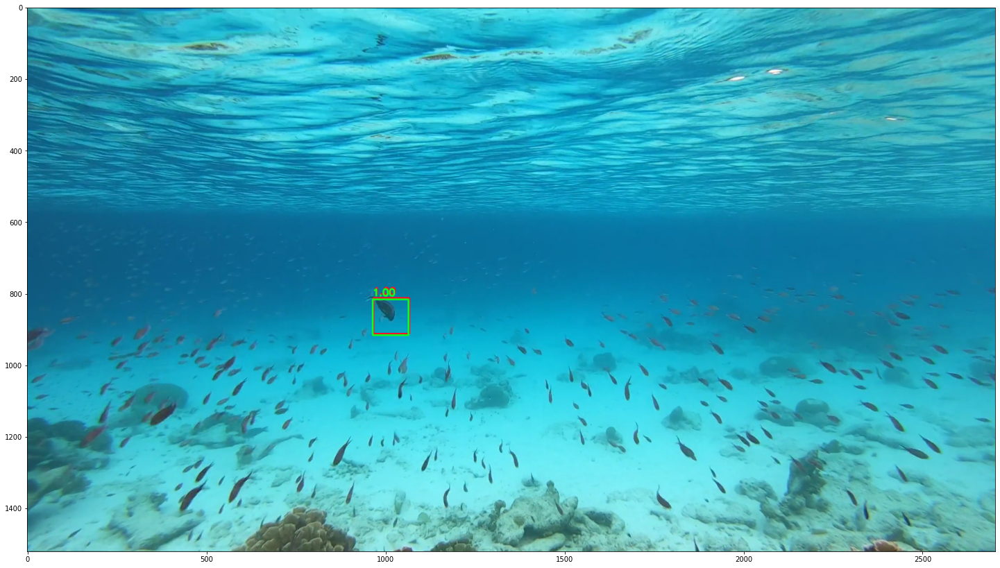

In [18]:
img_name = "144_A_00125.jpg"
# img_name = "160_A_00034" # Bad
# img_name = "442_C_00155" # Bad 
img_name = "455_A_00015.jpg" # Good
img_name = "160_A_00025.jpg"
img_name = "343_A_00026.jpg"
img_name = "373_A_00100.jpg"
img_name = "419_A_00090.jpg"
img_name = "419_A_00060.jpg"

# Setup a checkpoint file to load
checkpoint = '../work_dir/notebook_recreate/epoch_10.pth'
config = '../work_dir/notebook_recreate/fish_tracking_coco_recreate_notebook.py'
data_dir = '../data/2022_02_14_coco_format_select_vids'
visualise_img(img_name, data_dir, checkpoint, config)

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


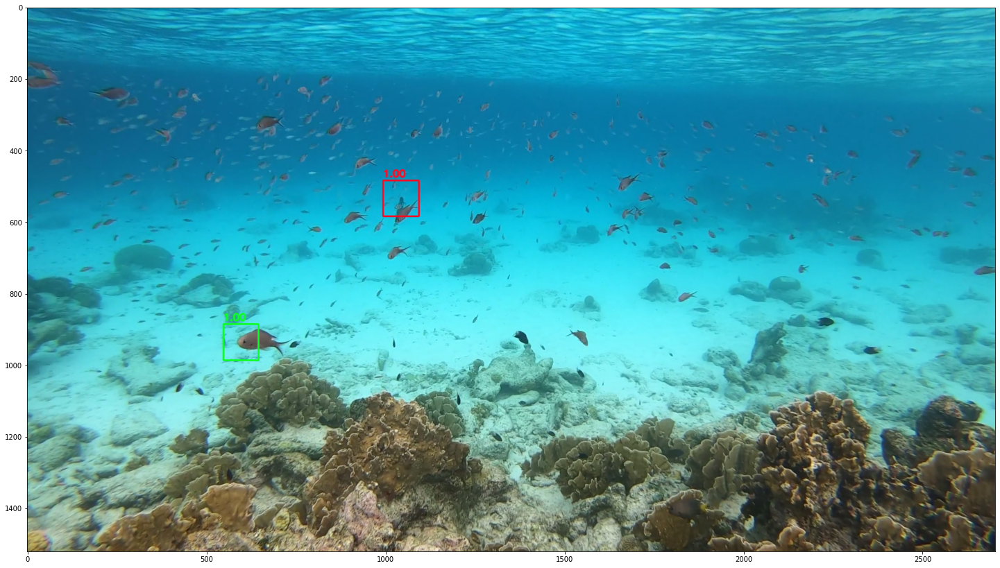

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


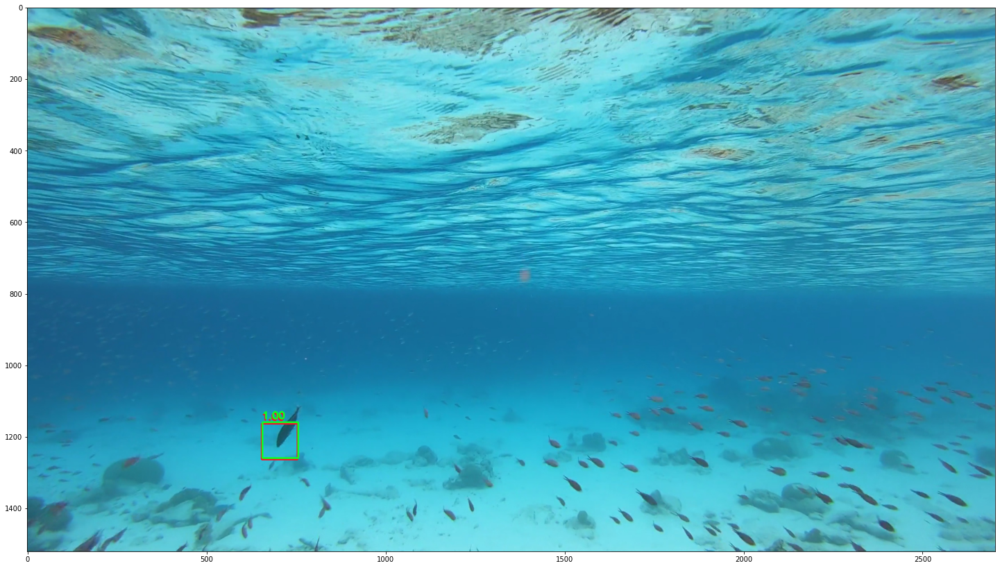

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


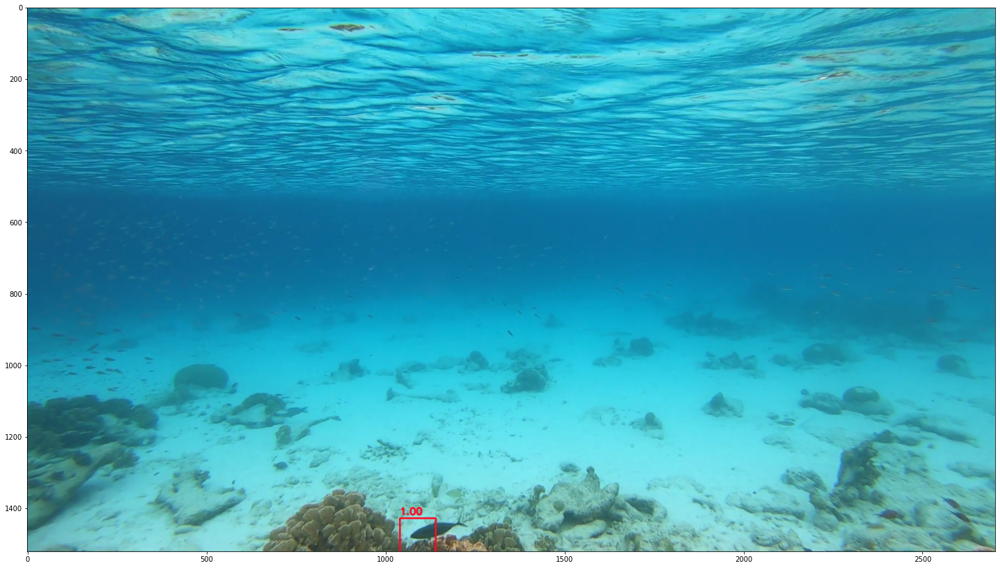

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


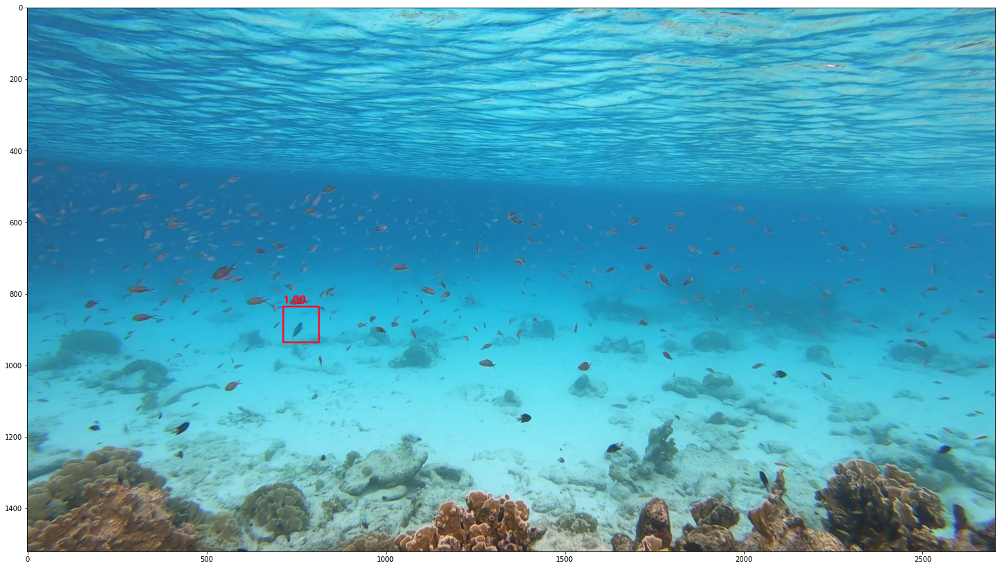

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


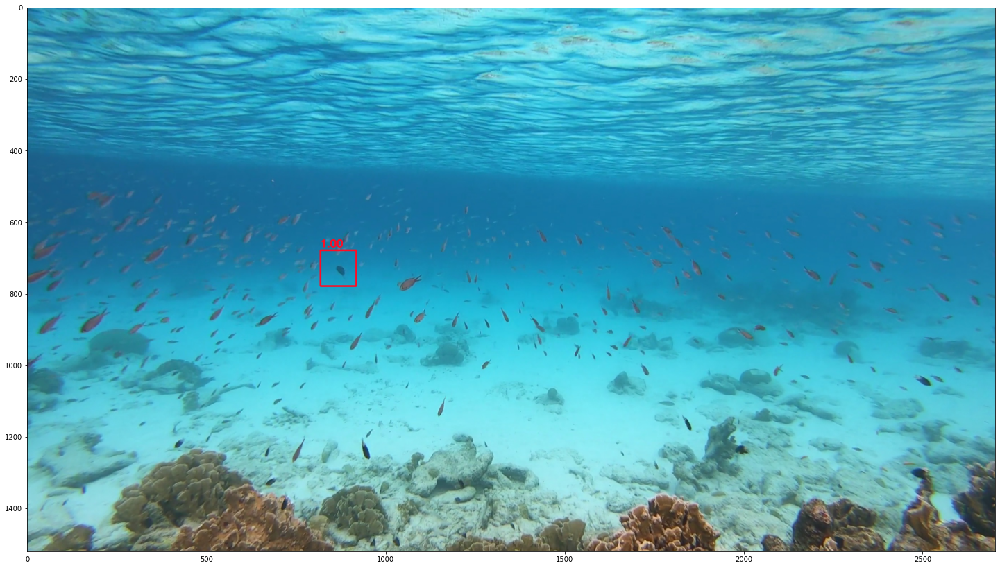

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


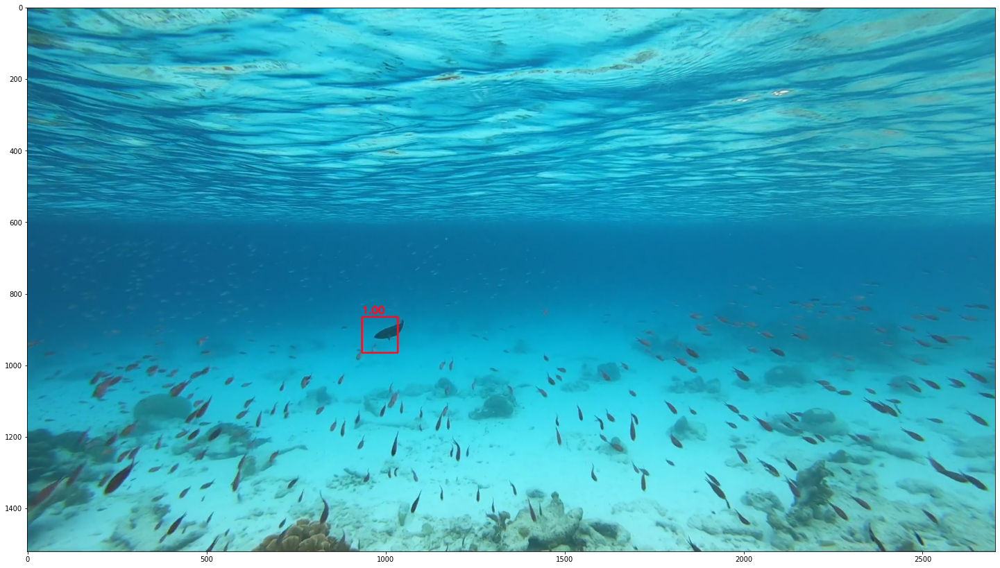

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


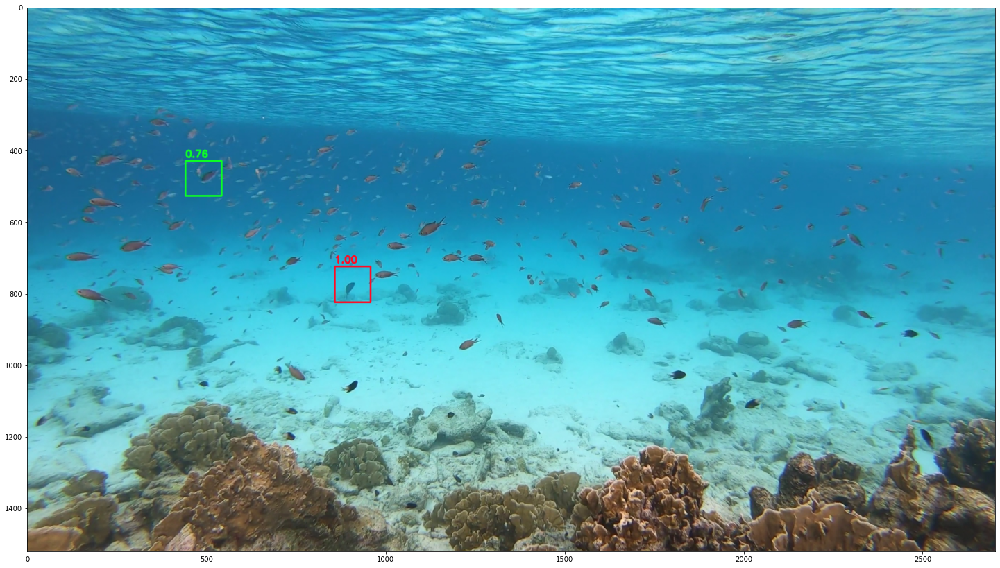

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


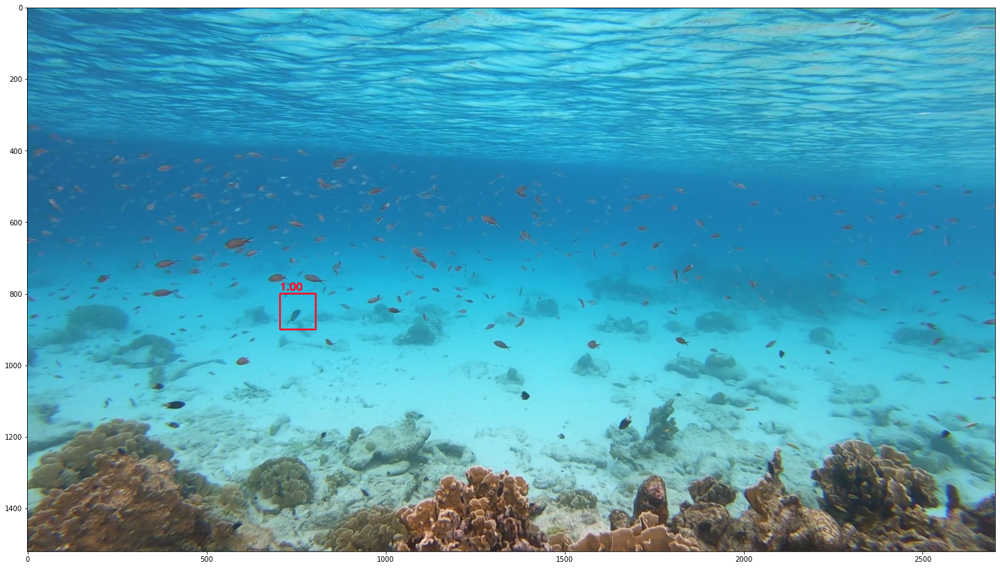

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


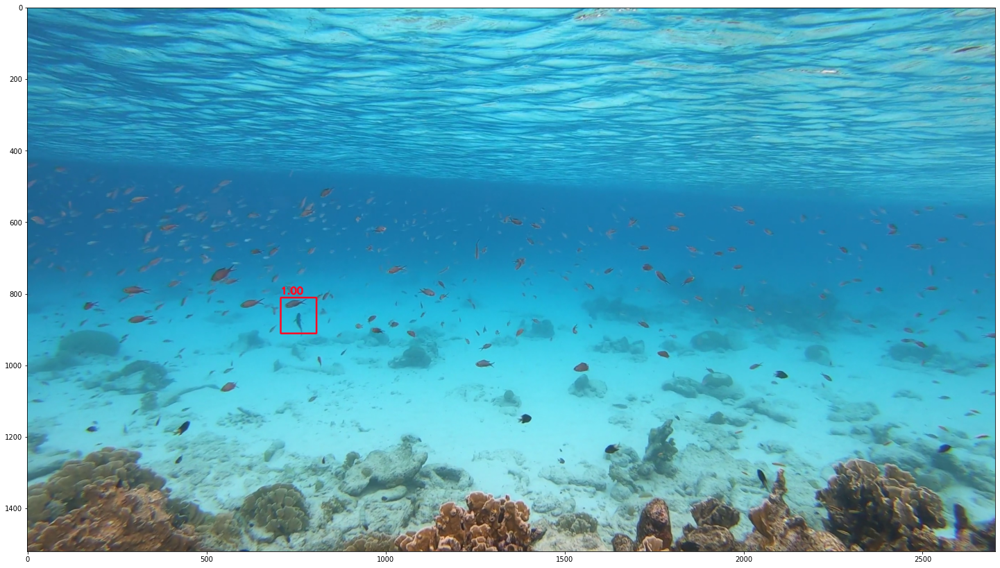

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


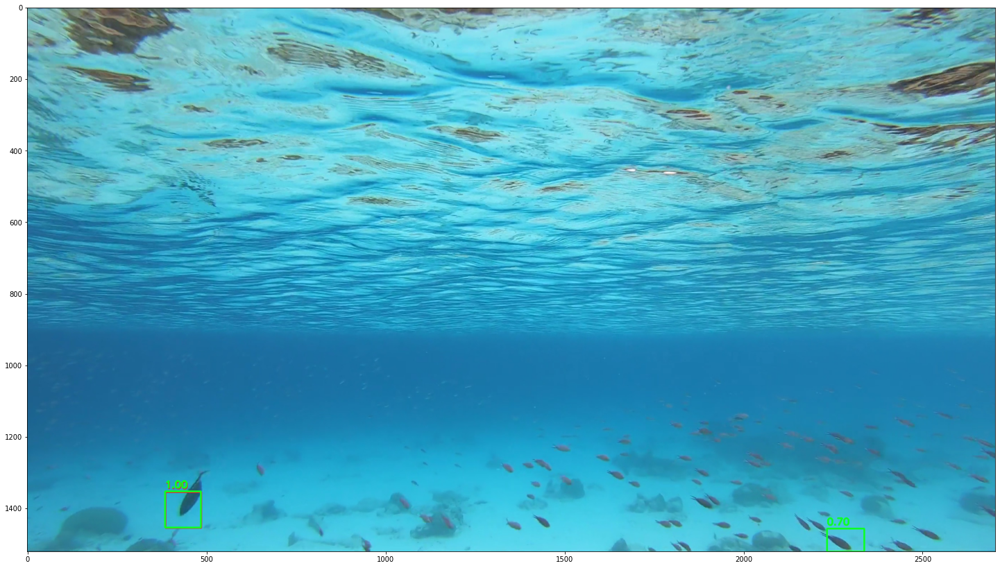

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


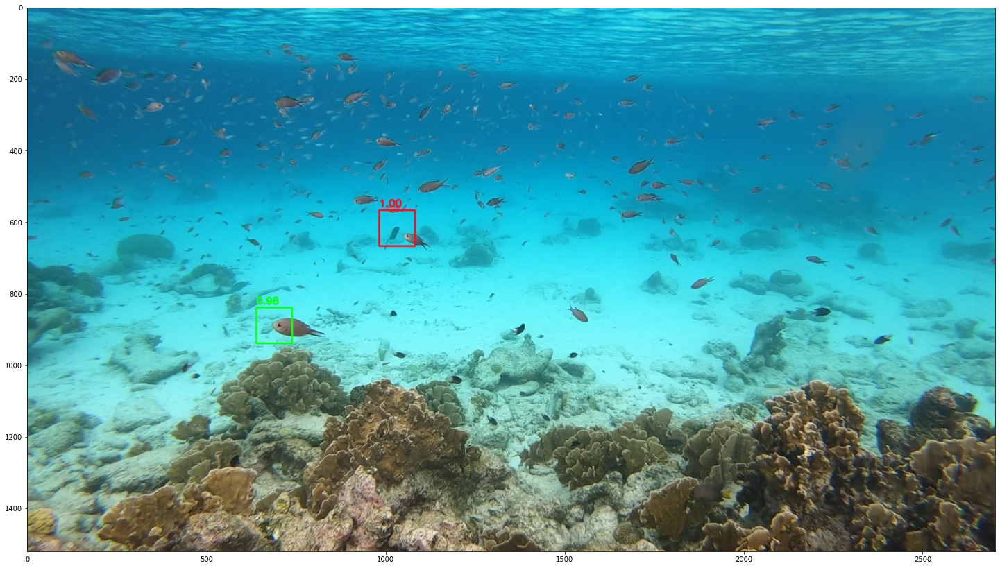

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


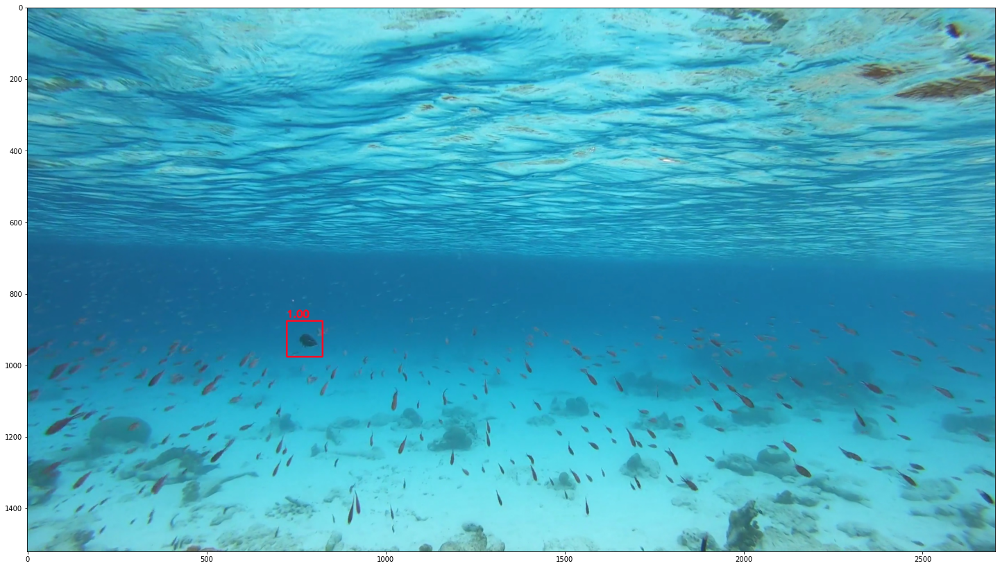

load checkpoint from local path: ../work_dir/notebook_recreate/epoch_10.pth


KeyboardInterrupt: 

In [19]:
img_prefix = "419"
for img in sorted(os.listdir(os.path.join(data_dir, "images"))):
    
    if img.split('_')[0] == img_prefix:
        visualise_img(img, data_dir, checkpoint, config)
    